In [8]:
# Libraries
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import fetch_lfw_people
import torch
from torch import nn, optim
from torch.utils.data import DataLoader, TensorDataset
import torchvision.utils as vutils
import torch.nn.functional as F
import imageio, glob
import os

In [9]:
# Set device to GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [10]:
# load lfw (all faces)
lfw = fetch_lfw_people(min_faces_per_person=0, resize=0.4, color=True)
images = lfw.images

# convert to tensor and preprocess
images = torch.from_numpy(images).permute(0, 3, 1, 2)
images = F.interpolate(images, size=(64, 64), mode='bilinear', align_corners=False)
images = (images - 0.5) / 0.5  # normalize to [-1, 1]

# debug: values should be between -1 and 1
print("Image min:", images.min().item(), "max:", images.max().item())

dataset = TensorDataset(images)
dataloader = DataLoader(dataset, batch_size=64, shuffle=True)

Image min: -1.0 max: 1.0


In [11]:
# generator
class generator(nn.Module):
    def __init__(self, d):
        super().__init__()
        self.model = nn.Sequential(
            nn.Linear(d, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.3),

            nn.Linear(512, 1024),
            nn.BatchNorm1d(1024),
            nn.ReLU(),
            nn.Dropout(0.3),

            nn.Linear(1024, 3 * 64 * 64),
            nn.Tanh()
        )

    def forward(self, z):
        out = self.model(z)
        return out.view(-1, 3, 64, 64)

# discriminator
class discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.model = nn.Sequential(
            nn.Flatten(),

            nn.Linear(3 * 64 * 64, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),

            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),

            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),

            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)

In [12]:
# Training loop
def train_gan(generator, discriminator, d, num_epochs):
    os.makedirs("gan_frames", exist_ok=True)
    criterion = nn.BCELoss()
    optimizer_g = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    optimizer_d = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999), weight_decay=1e-5)

    generator.to(device)
    discriminator.to(device)

    for epoch in range(num_epochs):
        for batch in dataloader:
            real_images = batch[0].to(device)
            batch_size = real_images.size(0)

            z = torch.randn(batch_size, d, device=device)
            fake_images = generator(z)

            real_labels = torch.full((batch_size, 1), 0.9, device=device)
            fake_labels = torch.zeros(batch_size, 1, device=device)

            outputs_real = discriminator(real_images)
            outputs_fake = discriminator(fake_images.detach())
            loss_d = criterion(outputs_real, real_labels) + criterion(outputs_fake, fake_labels)

            optimizer_d.zero_grad()
            loss_d.backward()
            optimizer_d.step()

            outputs = discriminator(fake_images)
            loss_g = criterion(outputs, real_labels)

            optimizer_g.zero_grad()
            loss_g.backward()
            optimizer_g.step()

        print(f"Epoch {epoch+1}/{num_epochs} | D Loss: {loss_d.item():.4f} | G Loss: {loss_g.item():.4f}")

        if (epoch + 1) % 10 == 0:
            with torch.no_grad():
                test_z = torch.randn(16, d, device=device)
                gen_imgs = generator(test_z).cpu()
                grid = vutils.make_grid(gen_imgs, nrow=4, normalize=True)
                plt.figure(figsize=(6, 6))
                plt.imshow(np.transpose(grid, (1, 2, 0)))
                plt.axis("off")
                plt.title(f"Generated Faces at Epoch {epoch+1}")
                plt.savefig(f"gan_frames/epoch_{epoch+1:03d}.png", bbox_inches='tight', pad_inches=0)
                plt.show()
                plt.close()

Training Basic GAN...
Epoch 1/500 | D Loss: 0.9189 | G Loss: 7.2899
Epoch 2/500 | D Loss: 0.8329 | G Loss: 5.2510
Epoch 3/500 | D Loss: 0.8642 | G Loss: 2.9043
Epoch 4/500 | D Loss: 0.9640 | G Loss: 1.8931
Epoch 5/500 | D Loss: 1.0244 | G Loss: 1.6916
Epoch 6/500 | D Loss: 0.9581 | G Loss: 1.7932
Epoch 7/500 | D Loss: 0.8470 | G Loss: 1.9818
Epoch 8/500 | D Loss: 0.8691 | G Loss: 2.2771
Epoch 9/500 | D Loss: 1.0008 | G Loss: 1.9018
Epoch 10/500 | D Loss: 1.0330 | G Loss: 2.3354


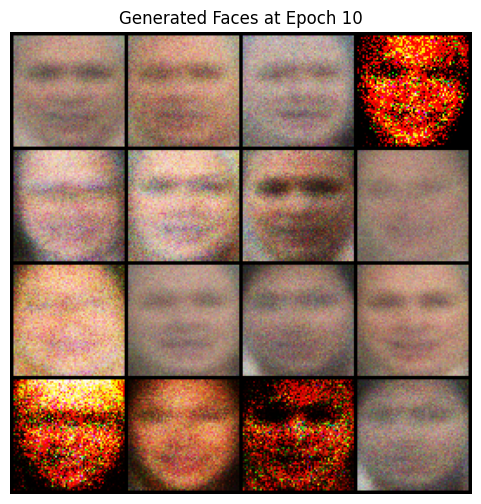

Epoch 11/500 | D Loss: 1.1950 | G Loss: 1.9513
Epoch 12/500 | D Loss: 1.1414 | G Loss: 2.6031
Epoch 13/500 | D Loss: 0.9976 | G Loss: 2.0065
Epoch 14/500 | D Loss: 1.2600 | G Loss: 1.6567
Epoch 15/500 | D Loss: 1.1428 | G Loss: 2.0414
Epoch 16/500 | D Loss: 1.1676 | G Loss: 1.4622
Epoch 17/500 | D Loss: 1.0153 | G Loss: 2.0656
Epoch 18/500 | D Loss: 1.2429 | G Loss: 2.5552
Epoch 19/500 | D Loss: 1.1212 | G Loss: 1.9739
Epoch 20/500 | D Loss: 1.3552 | G Loss: 1.3307


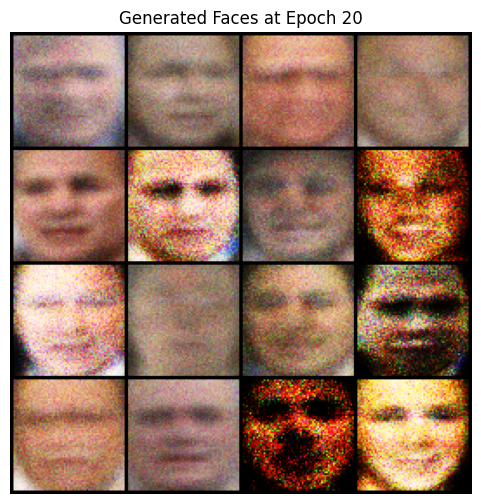

Epoch 21/500 | D Loss: 1.1333 | G Loss: 1.7711
Epoch 22/500 | D Loss: 1.1658 | G Loss: 1.2100
Epoch 23/500 | D Loss: 1.1964 | G Loss: 2.1172
Epoch 24/500 | D Loss: 1.1385 | G Loss: 1.8424
Epoch 25/500 | D Loss: 1.2294 | G Loss: 1.5727
Epoch 26/500 | D Loss: 1.1306 | G Loss: 1.6442
Epoch 27/500 | D Loss: 1.2640 | G Loss: 1.1385
Epoch 28/500 | D Loss: 1.2269 | G Loss: 1.2304
Epoch 29/500 | D Loss: 1.2002 | G Loss: 1.5113
Epoch 30/500 | D Loss: 1.2987 | G Loss: 1.0957


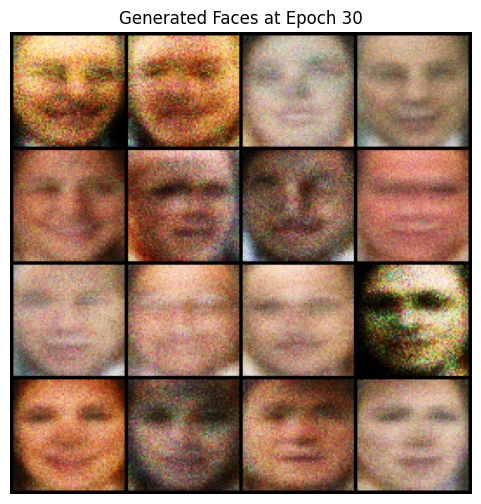

Epoch 31/500 | D Loss: 1.1501 | G Loss: 1.6031
Epoch 32/500 | D Loss: 1.2163 | G Loss: 1.3270
Epoch 33/500 | D Loss: 1.1873 | G Loss: 1.1278
Epoch 34/500 | D Loss: 1.2268 | G Loss: 1.3255
Epoch 35/500 | D Loss: 1.2712 | G Loss: 1.0184
Epoch 36/500 | D Loss: 1.3224 | G Loss: 1.0836
Epoch 37/500 | D Loss: 1.1895 | G Loss: 1.1820
Epoch 38/500 | D Loss: 1.1958 | G Loss: 0.9206
Epoch 39/500 | D Loss: 1.1320 | G Loss: 1.1805
Epoch 40/500 | D Loss: 1.3164 | G Loss: 0.9236


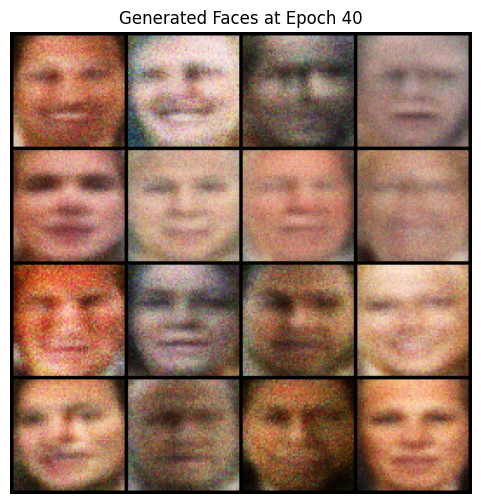

Epoch 41/500 | D Loss: 1.2271 | G Loss: 1.2250
Epoch 42/500 | D Loss: 1.3843 | G Loss: 1.1825
Epoch 43/500 | D Loss: 1.2416 | G Loss: 1.0384
Epoch 44/500 | D Loss: 1.4389 | G Loss: 0.8759
Epoch 45/500 | D Loss: 1.2610 | G Loss: 1.0195
Epoch 46/500 | D Loss: 1.2875 | G Loss: 0.9908
Epoch 47/500 | D Loss: 1.2455 | G Loss: 1.0576
Epoch 48/500 | D Loss: 1.3429 | G Loss: 0.9683
Epoch 49/500 | D Loss: 1.2409 | G Loss: 1.1515
Epoch 50/500 | D Loss: 1.3479 | G Loss: 0.9664


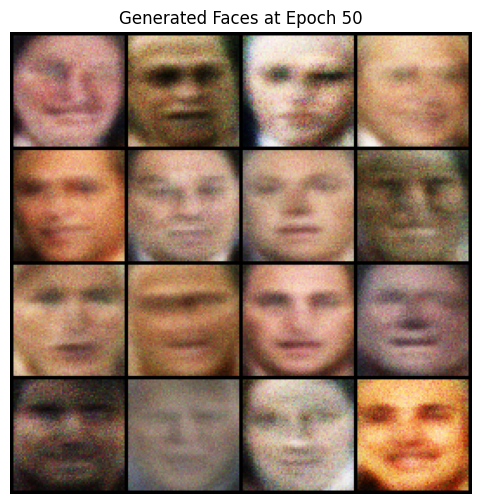

Epoch 51/500 | D Loss: 1.4194 | G Loss: 0.9658
Epoch 52/500 | D Loss: 1.3397 | G Loss: 1.2205
Epoch 53/500 | D Loss: 1.2621 | G Loss: 0.9061
Epoch 54/500 | D Loss: 1.2497 | G Loss: 0.9474
Epoch 55/500 | D Loss: 1.2877 | G Loss: 0.8754
Epoch 56/500 | D Loss: 1.4195 | G Loss: 0.8556
Epoch 57/500 | D Loss: 1.3699 | G Loss: 1.0497
Epoch 58/500 | D Loss: 1.3108 | G Loss: 1.1049
Epoch 59/500 | D Loss: 1.2516 | G Loss: 1.0456
Epoch 60/500 | D Loss: 1.3148 | G Loss: 0.9030


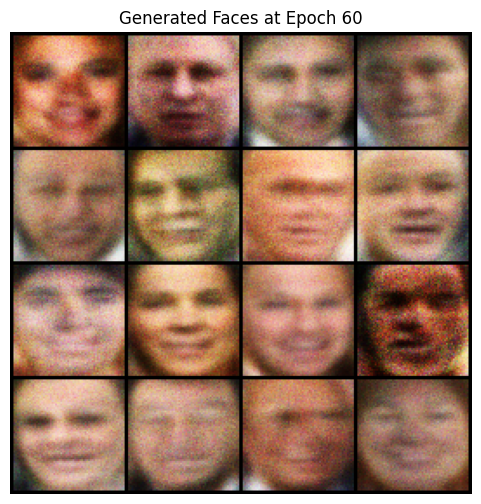

Epoch 61/500 | D Loss: 1.4395 | G Loss: 0.9879
Epoch 62/500 | D Loss: 1.3870 | G Loss: 0.9050
Epoch 63/500 | D Loss: 1.2350 | G Loss: 0.9063
Epoch 64/500 | D Loss: 1.3634 | G Loss: 0.9799
Epoch 65/500 | D Loss: 1.3514 | G Loss: 0.9601
Epoch 66/500 | D Loss: 1.3508 | G Loss: 0.9928
Epoch 67/500 | D Loss: 1.3216 | G Loss: 1.0201
Epoch 68/500 | D Loss: 1.3006 | G Loss: 0.8870
Epoch 69/500 | D Loss: 1.3446 | G Loss: 0.9772
Epoch 70/500 | D Loss: 1.3838 | G Loss: 0.9416


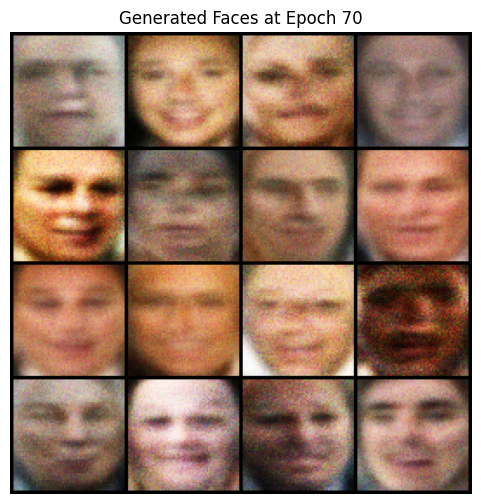

Epoch 71/500 | D Loss: 1.2987 | G Loss: 0.9571
Epoch 72/500 | D Loss: 1.3521 | G Loss: 0.9605
Epoch 73/500 | D Loss: 1.3890 | G Loss: 0.8102
Epoch 74/500 | D Loss: 1.3607 | G Loss: 0.9314
Epoch 75/500 | D Loss: 1.3758 | G Loss: 1.0239
Epoch 76/500 | D Loss: 1.3899 | G Loss: 0.9120
Epoch 77/500 | D Loss: 1.3511 | G Loss: 0.9328
Epoch 78/500 | D Loss: 1.3695 | G Loss: 0.8762
Epoch 79/500 | D Loss: 1.3662 | G Loss: 0.9167
Epoch 80/500 | D Loss: 1.3083 | G Loss: 1.1885


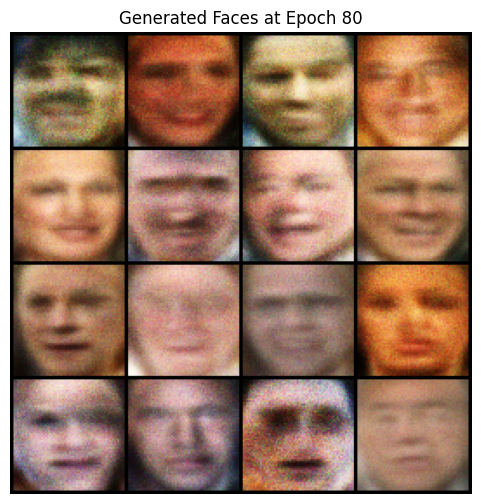

Epoch 81/500 | D Loss: 1.4519 | G Loss: 0.8199
Epoch 82/500 | D Loss: 1.2755 | G Loss: 0.7821
Epoch 83/500 | D Loss: 1.4175 | G Loss: 0.9395
Epoch 84/500 | D Loss: 1.3229 | G Loss: 0.8519
Epoch 85/500 | D Loss: 1.3506 | G Loss: 0.8206
Epoch 86/500 | D Loss: 1.3855 | G Loss: 0.8193
Epoch 87/500 | D Loss: 1.3847 | G Loss: 0.8583
Epoch 88/500 | D Loss: 1.3279 | G Loss: 0.9691
Epoch 89/500 | D Loss: 1.3776 | G Loss: 0.7948
Epoch 90/500 | D Loss: 1.3620 | G Loss: 0.8895


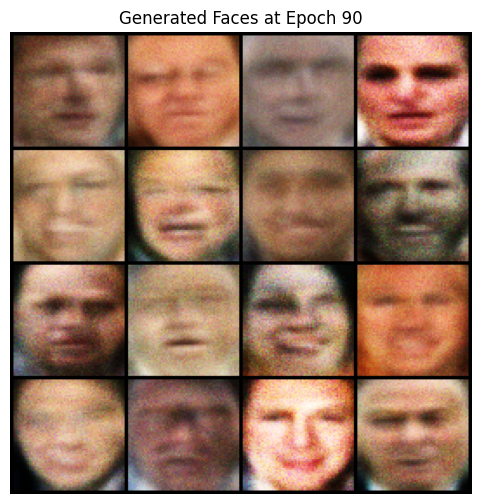

Epoch 91/500 | D Loss: 1.2551 | G Loss: 1.0132
Epoch 92/500 | D Loss: 1.4313 | G Loss: 0.7907
Epoch 93/500 | D Loss: 1.3310 | G Loss: 0.7990
Epoch 94/500 | D Loss: 1.3199 | G Loss: 1.0364
Epoch 95/500 | D Loss: 1.3663 | G Loss: 0.8387
Epoch 96/500 | D Loss: 1.3856 | G Loss: 1.1068
Epoch 97/500 | D Loss: 1.3867 | G Loss: 0.8612
Epoch 98/500 | D Loss: 1.4065 | G Loss: 0.8373
Epoch 99/500 | D Loss: 1.3709 | G Loss: 0.8072
Epoch 100/500 | D Loss: 1.3551 | G Loss: 0.8525


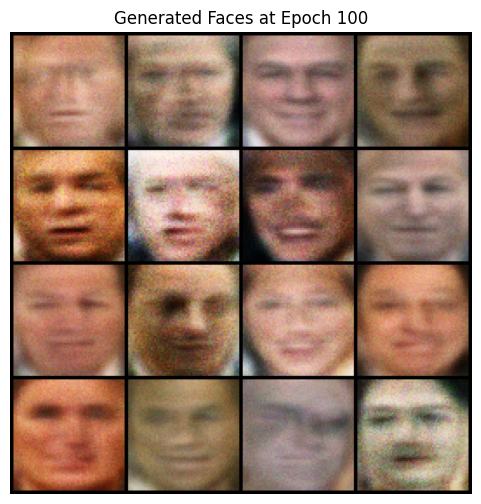

Epoch 101/500 | D Loss: 1.4171 | G Loss: 0.8858
Epoch 102/500 | D Loss: 1.3834 | G Loss: 0.7997
Epoch 103/500 | D Loss: 1.3632 | G Loss: 0.7787
Epoch 104/500 | D Loss: 1.3261 | G Loss: 0.8661
Epoch 105/500 | D Loss: 1.3787 | G Loss: 0.8698
Epoch 106/500 | D Loss: 1.3328 | G Loss: 0.9087
Epoch 107/500 | D Loss: 1.3467 | G Loss: 0.8682
Epoch 108/500 | D Loss: 1.2829 | G Loss: 0.9587
Epoch 109/500 | D Loss: 1.2831 | G Loss: 0.9663
Epoch 110/500 | D Loss: 1.4108 | G Loss: 0.8661


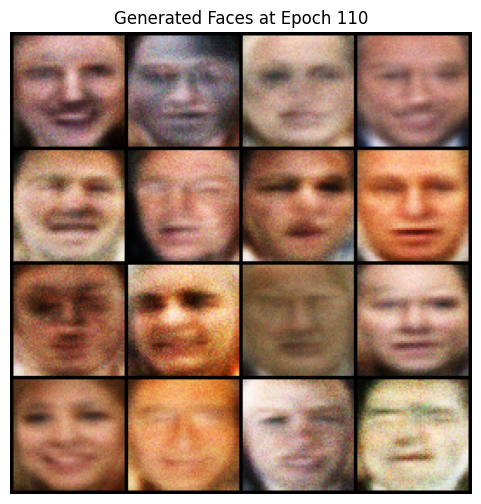

Epoch 111/500 | D Loss: 1.3300 | G Loss: 0.9044
Epoch 112/500 | D Loss: 1.3958 | G Loss: 1.0290
Epoch 113/500 | D Loss: 1.3546 | G Loss: 0.8855
Epoch 114/500 | D Loss: 1.4325 | G Loss: 0.8149
Epoch 115/500 | D Loss: 1.3389 | G Loss: 0.7968
Epoch 116/500 | D Loss: 1.3577 | G Loss: 0.8805
Epoch 117/500 | D Loss: 1.3359 | G Loss: 0.7731
Epoch 118/500 | D Loss: 1.3519 | G Loss: 0.7916
Epoch 119/500 | D Loss: 1.3912 | G Loss: 0.8384
Epoch 120/500 | D Loss: 1.3267 | G Loss: 0.9026


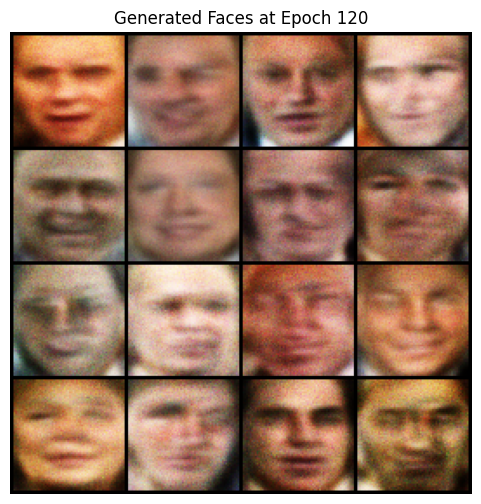

Epoch 121/500 | D Loss: 1.3598 | G Loss: 0.8425
Epoch 122/500 | D Loss: 1.4040 | G Loss: 0.8614
Epoch 123/500 | D Loss: 1.3242 | G Loss: 0.9313
Epoch 124/500 | D Loss: 1.3044 | G Loss: 0.9172
Epoch 125/500 | D Loss: 1.3036 | G Loss: 0.8711
Epoch 126/500 | D Loss: 1.3334 | G Loss: 0.8556
Epoch 127/500 | D Loss: 1.3133 | G Loss: 0.8473
Epoch 128/500 | D Loss: 1.3461 | G Loss: 0.9119
Epoch 129/500 | D Loss: 1.4136 | G Loss: 0.8804
Epoch 130/500 | D Loss: 1.4051 | G Loss: 0.8559


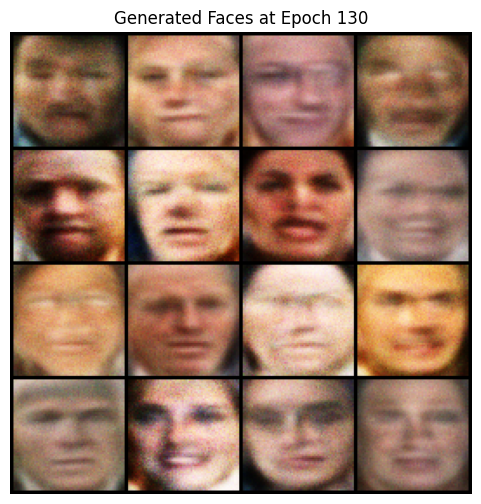

Epoch 131/500 | D Loss: 1.3210 | G Loss: 0.7869
Epoch 132/500 | D Loss: 1.4395 | G Loss: 0.8217
Epoch 133/500 | D Loss: 1.3674 | G Loss: 0.8441
Epoch 134/500 | D Loss: 1.4218 | G Loss: 0.8855
Epoch 135/500 | D Loss: 1.3076 | G Loss: 0.7786
Epoch 136/500 | D Loss: 1.2481 | G Loss: 0.8680
Epoch 137/500 | D Loss: 1.4025 | G Loss: 0.9169
Epoch 138/500 | D Loss: 1.3729 | G Loss: 0.8204
Epoch 139/500 | D Loss: 1.3079 | G Loss: 0.9558
Epoch 140/500 | D Loss: 1.3428 | G Loss: 0.9155


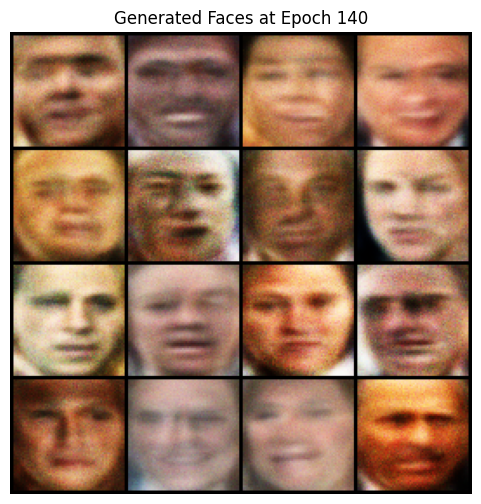

Epoch 141/500 | D Loss: 1.3214 | G Loss: 0.8444
Epoch 142/500 | D Loss: 1.3458 | G Loss: 0.8871
Epoch 143/500 | D Loss: 1.2595 | G Loss: 0.8159
Epoch 144/500 | D Loss: 1.3352 | G Loss: 0.8392
Epoch 145/500 | D Loss: 1.3454 | G Loss: 0.8012
Epoch 146/500 | D Loss: 1.3286 | G Loss: 0.9457
Epoch 147/500 | D Loss: 1.3453 | G Loss: 0.7892
Epoch 148/500 | D Loss: 1.3020 | G Loss: 0.8815
Epoch 149/500 | D Loss: 1.3686 | G Loss: 0.7588
Epoch 150/500 | D Loss: 1.3354 | G Loss: 0.8964


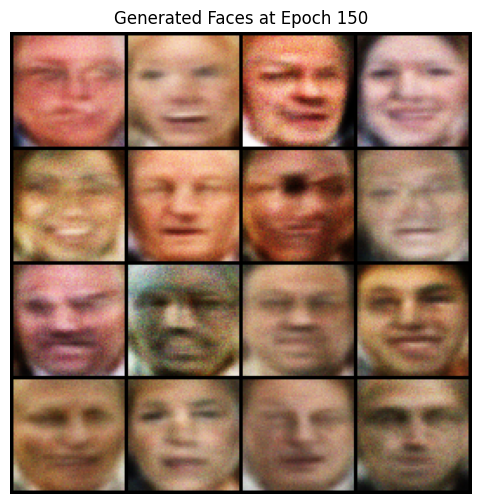

Epoch 151/500 | D Loss: 1.4367 | G Loss: 0.9017
Epoch 152/500 | D Loss: 1.3617 | G Loss: 0.8379
Epoch 153/500 | D Loss: 1.3689 | G Loss: 0.8368
Epoch 154/500 | D Loss: 1.3440 | G Loss: 0.8623
Epoch 155/500 | D Loss: 1.3597 | G Loss: 0.8291
Epoch 156/500 | D Loss: 1.3618 | G Loss: 0.7981
Epoch 157/500 | D Loss: 1.3515 | G Loss: 0.8451
Epoch 158/500 | D Loss: 1.3449 | G Loss: 0.8307
Epoch 159/500 | D Loss: 1.3331 | G Loss: 0.9060
Epoch 160/500 | D Loss: 1.3611 | G Loss: 0.8766


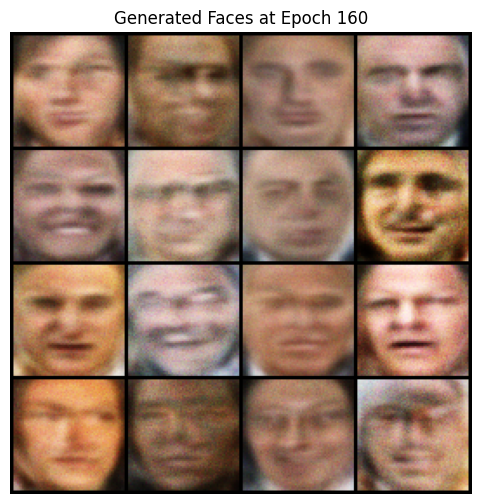

Epoch 161/500 | D Loss: 1.3421 | G Loss: 0.8353
Epoch 162/500 | D Loss: 1.3987 | G Loss: 0.7972
Epoch 163/500 | D Loss: 1.3441 | G Loss: 0.8772
Epoch 164/500 | D Loss: 1.3481 | G Loss: 0.8788
Epoch 165/500 | D Loss: 1.4081 | G Loss: 0.9747
Epoch 166/500 | D Loss: 1.3759 | G Loss: 0.8338
Epoch 167/500 | D Loss: 1.3353 | G Loss: 0.8387
Epoch 168/500 | D Loss: 1.3403 | G Loss: 0.9071
Epoch 169/500 | D Loss: 1.3807 | G Loss: 0.8118
Epoch 170/500 | D Loss: 1.3697 | G Loss: 0.8155


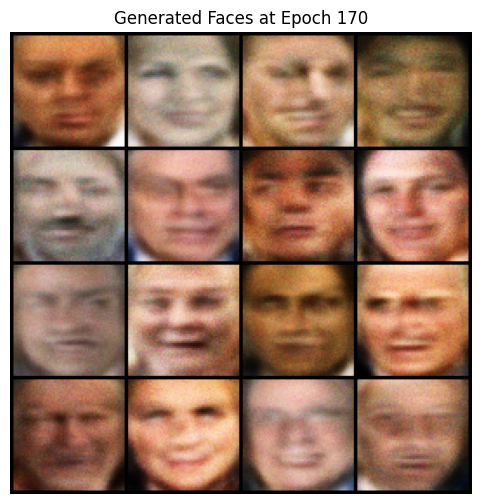

Epoch 171/500 | D Loss: 1.3001 | G Loss: 0.8057
Epoch 172/500 | D Loss: 1.3789 | G Loss: 0.8052
Epoch 173/500 | D Loss: 1.3701 | G Loss: 0.8512
Epoch 174/500 | D Loss: 1.4055 | G Loss: 0.8326
Epoch 175/500 | D Loss: 1.3792 | G Loss: 0.8139
Epoch 176/500 | D Loss: 1.3738 | G Loss: 0.7939
Epoch 177/500 | D Loss: 1.3254 | G Loss: 0.8025
Epoch 178/500 | D Loss: 1.3955 | G Loss: 0.8044
Epoch 179/500 | D Loss: 1.3352 | G Loss: 0.9011
Epoch 180/500 | D Loss: 1.4213 | G Loss: 0.7960


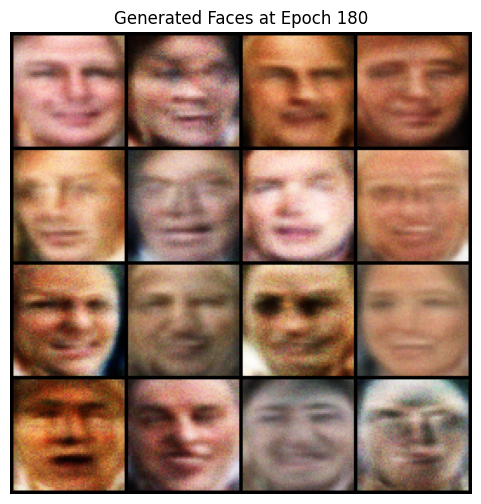

Epoch 181/500 | D Loss: 1.3402 | G Loss: 0.8071
Epoch 182/500 | D Loss: 1.3273 | G Loss: 0.8173
Epoch 183/500 | D Loss: 1.3843 | G Loss: 0.7792
Epoch 184/500 | D Loss: 1.3984 | G Loss: 0.7981
Epoch 185/500 | D Loss: 1.3706 | G Loss: 0.8381
Epoch 186/500 | D Loss: 1.3493 | G Loss: 0.7987
Epoch 187/500 | D Loss: 1.3871 | G Loss: 0.8703
Epoch 188/500 | D Loss: 1.3374 | G Loss: 0.8225
Epoch 189/500 | D Loss: 1.3832 | G Loss: 0.7775
Epoch 190/500 | D Loss: 1.4017 | G Loss: 0.8298


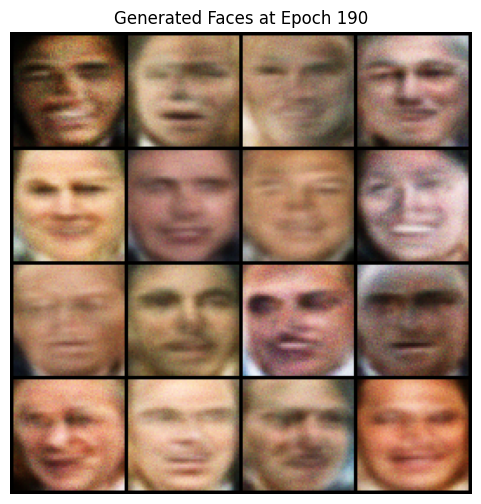

Epoch 191/500 | D Loss: 1.3635 | G Loss: 0.7515
Epoch 192/500 | D Loss: 1.3561 | G Loss: 0.8121
Epoch 193/500 | D Loss: 1.3402 | G Loss: 0.8060
Epoch 194/500 | D Loss: 1.4005 | G Loss: 0.7861
Epoch 195/500 | D Loss: 1.3398 | G Loss: 0.8019
Epoch 196/500 | D Loss: 1.4053 | G Loss: 0.7879
Epoch 197/500 | D Loss: 1.3976 | G Loss: 0.9114
Epoch 198/500 | D Loss: 1.3792 | G Loss: 0.8301
Epoch 199/500 | D Loss: 1.3754 | G Loss: 0.7949
Epoch 200/500 | D Loss: 1.3729 | G Loss: 0.8451


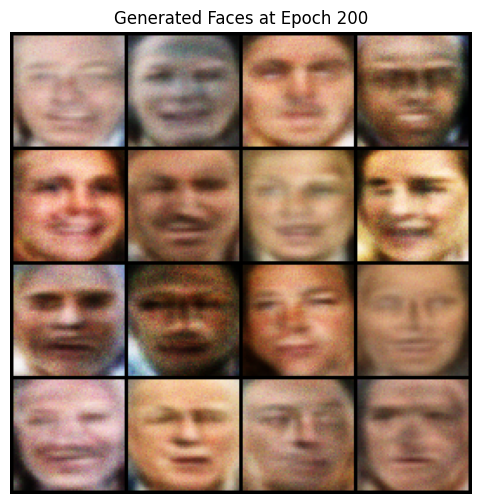

Epoch 201/500 | D Loss: 1.3364 | G Loss: 0.8340
Epoch 202/500 | D Loss: 1.4233 | G Loss: 0.8578
Epoch 203/500 | D Loss: 1.3736 | G Loss: 0.7934
Epoch 204/500 | D Loss: 1.3577 | G Loss: 0.8008
Epoch 205/500 | D Loss: 1.3918 | G Loss: 0.7989
Epoch 206/500 | D Loss: 1.3557 | G Loss: 0.8124
Epoch 207/500 | D Loss: 1.3578 | G Loss: 0.8072
Epoch 208/500 | D Loss: 1.3842 | G Loss: 0.8061
Epoch 209/500 | D Loss: 1.3439 | G Loss: 0.8025
Epoch 210/500 | D Loss: 1.3974 | G Loss: 0.8011


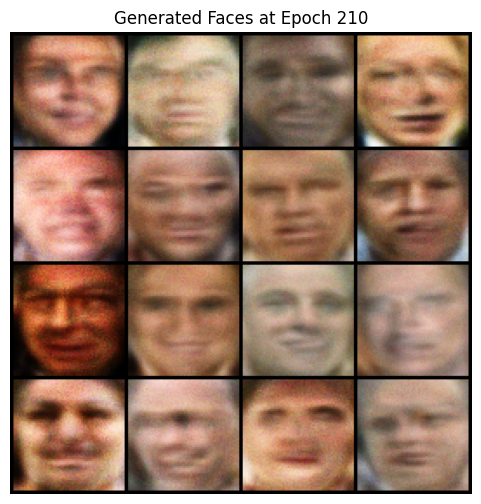

Epoch 211/500 | D Loss: 1.3989 | G Loss: 0.7643
Epoch 212/500 | D Loss: 1.3575 | G Loss: 0.8256
Epoch 213/500 | D Loss: 1.3905 | G Loss: 0.7941
Epoch 214/500 | D Loss: 1.3649 | G Loss: 0.8317
Epoch 215/500 | D Loss: 1.3349 | G Loss: 0.8246
Epoch 216/500 | D Loss: 1.3904 | G Loss: 0.7875
Epoch 217/500 | D Loss: 1.3848 | G Loss: 0.8060
Epoch 218/500 | D Loss: 1.3507 | G Loss: 0.8223
Epoch 219/500 | D Loss: 1.3324 | G Loss: 0.8587
Epoch 220/500 | D Loss: 1.3619 | G Loss: 0.7978


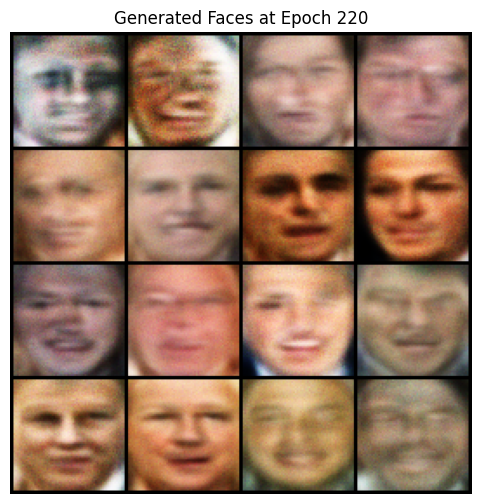

Epoch 221/500 | D Loss: 1.3674 | G Loss: 0.8080
Epoch 222/500 | D Loss: 1.3868 | G Loss: 0.7903
Epoch 223/500 | D Loss: 1.3832 | G Loss: 0.7669
Epoch 224/500 | D Loss: 1.3969 | G Loss: 0.7815
Epoch 225/500 | D Loss: 1.3543 | G Loss: 0.8443
Epoch 226/500 | D Loss: 1.3998 | G Loss: 0.8025
Epoch 227/500 | D Loss: 1.3577 | G Loss: 0.7794
Epoch 228/500 | D Loss: 1.3839 | G Loss: 0.7843
Epoch 229/500 | D Loss: 1.3808 | G Loss: 0.7686
Epoch 230/500 | D Loss: 1.3751 | G Loss: 0.7991


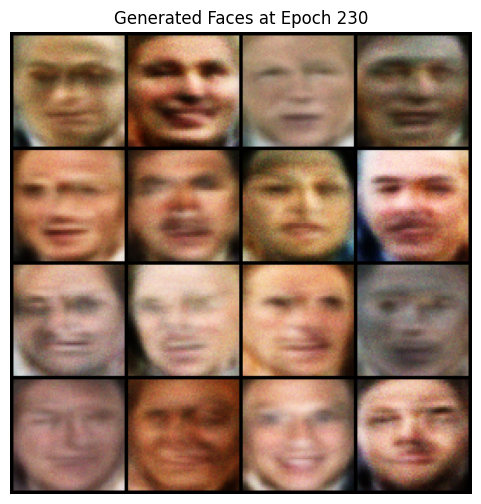

Epoch 231/500 | D Loss: 1.3476 | G Loss: 0.7611
Epoch 232/500 | D Loss: 1.3793 | G Loss: 0.8052
Epoch 233/500 | D Loss: 1.3737 | G Loss: 0.8061
Epoch 234/500 | D Loss: 1.3813 | G Loss: 0.8035
Epoch 235/500 | D Loss: 1.3626 | G Loss: 0.7661
Epoch 236/500 | D Loss: 1.3903 | G Loss: 0.7735
Epoch 237/500 | D Loss: 1.3855 | G Loss: 0.8124
Epoch 238/500 | D Loss: 1.3570 | G Loss: 0.8138
Epoch 239/500 | D Loss: 1.3775 | G Loss: 0.8074
Epoch 240/500 | D Loss: 1.3443 | G Loss: 0.7933


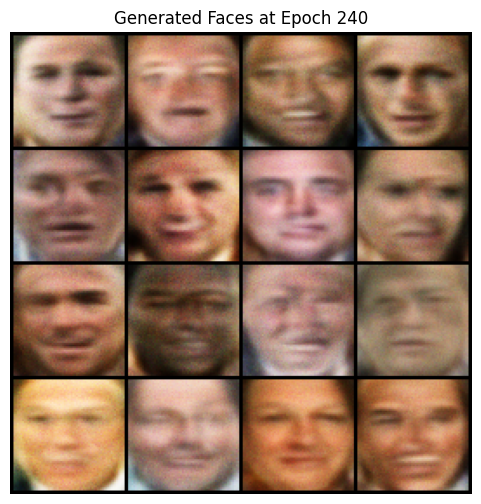

Epoch 241/500 | D Loss: 1.3863 | G Loss: 0.7416
Epoch 242/500 | D Loss: 1.3978 | G Loss: 0.7819
Epoch 243/500 | D Loss: 1.3534 | G Loss: 0.7840
Epoch 244/500 | D Loss: 1.3617 | G Loss: 0.8061
Epoch 245/500 | D Loss: 1.3853 | G Loss: 0.8042
Epoch 246/500 | D Loss: 1.3608 | G Loss: 0.7721
Epoch 247/500 | D Loss: 1.3514 | G Loss: 0.8221
Epoch 248/500 | D Loss: 1.3678 | G Loss: 0.8118
Epoch 249/500 | D Loss: 1.3780 | G Loss: 0.7946
Epoch 250/500 | D Loss: 1.3462 | G Loss: 0.8188


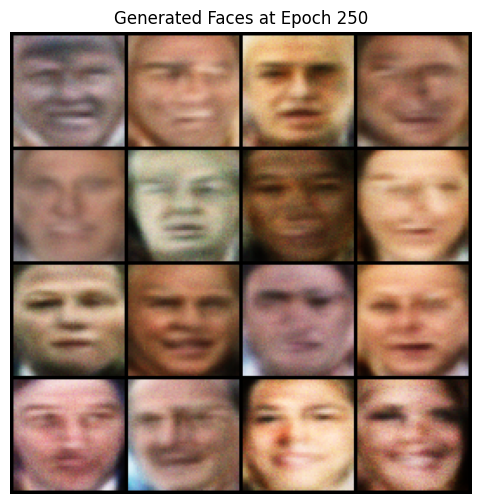

Epoch 251/500 | D Loss: 1.3776 | G Loss: 0.8037
Epoch 252/500 | D Loss: 1.3690 | G Loss: 0.8118
Epoch 253/500 | D Loss: 1.3904 | G Loss: 0.7805
Epoch 254/500 | D Loss: 1.3751 | G Loss: 0.8103
Epoch 255/500 | D Loss: 1.3593 | G Loss: 0.7811
Epoch 256/500 | D Loss: 1.3841 | G Loss: 0.7706
Epoch 257/500 | D Loss: 1.3779 | G Loss: 0.7894
Epoch 258/500 | D Loss: 1.3864 | G Loss: 0.7682
Epoch 259/500 | D Loss: 1.3731 | G Loss: 0.8136
Epoch 260/500 | D Loss: 1.3834 | G Loss: 0.7915


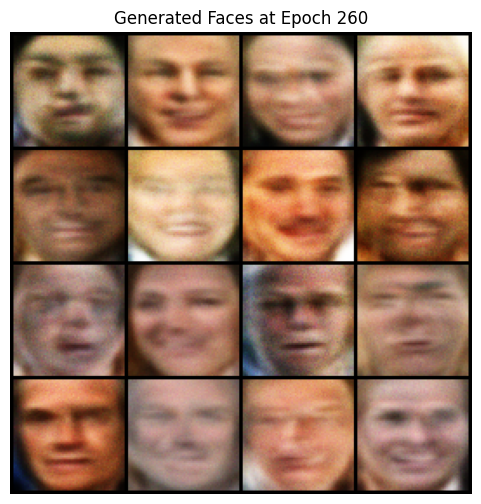

Epoch 261/500 | D Loss: 1.3815 | G Loss: 0.7653
Epoch 262/500 | D Loss: 1.3850 | G Loss: 0.8348
Epoch 263/500 | D Loss: 1.3759 | G Loss: 0.7883
Epoch 264/500 | D Loss: 1.3803 | G Loss: 0.8079
Epoch 265/500 | D Loss: 1.3744 | G Loss: 0.7909
Epoch 266/500 | D Loss: 1.3624 | G Loss: 0.7645
Epoch 267/500 | D Loss: 1.3596 | G Loss: 0.8282
Epoch 268/500 | D Loss: 1.3455 | G Loss: 0.8083
Epoch 269/500 | D Loss: 1.3579 | G Loss: 0.7970
Epoch 270/500 | D Loss: 1.4053 | G Loss: 0.7870


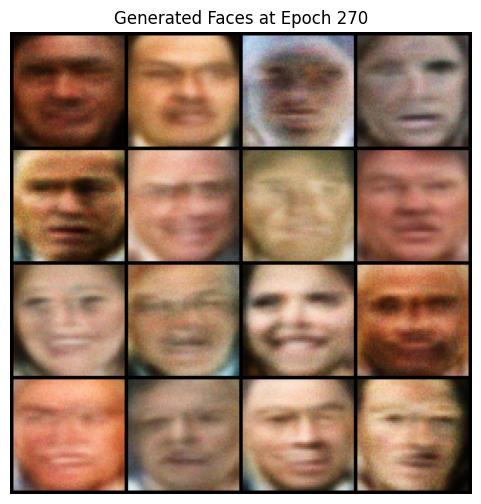

Epoch 271/500 | D Loss: 1.3784 | G Loss: 0.7957
Epoch 272/500 | D Loss: 1.3785 | G Loss: 0.7642
Epoch 273/500 | D Loss: 1.3648 | G Loss: 0.8070
Epoch 274/500 | D Loss: 1.3980 | G Loss: 0.7712
Epoch 275/500 | D Loss: 1.4008 | G Loss: 0.7801
Epoch 276/500 | D Loss: 1.3852 | G Loss: 0.7741
Epoch 277/500 | D Loss: 1.3711 | G Loss: 0.7649
Epoch 278/500 | D Loss: 1.3766 | G Loss: 0.7879
Epoch 279/500 | D Loss: 1.3742 | G Loss: 0.7875
Epoch 280/500 | D Loss: 1.4101 | G Loss: 0.7974


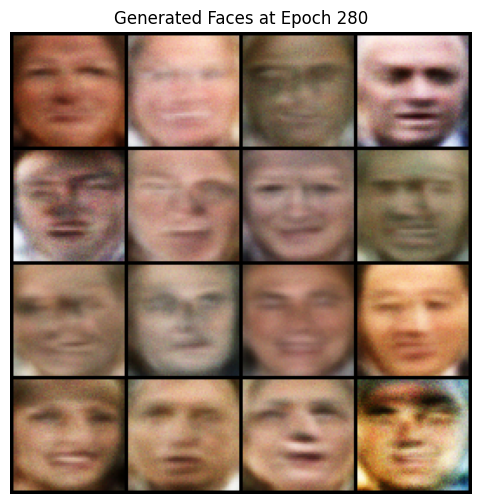

Epoch 281/500 | D Loss: 1.3858 | G Loss: 0.7853
Epoch 282/500 | D Loss: 1.3922 | G Loss: 0.7666
Epoch 283/500 | D Loss: 1.3740 | G Loss: 0.7980
Epoch 284/500 | D Loss: 1.3595 | G Loss: 0.8169
Epoch 285/500 | D Loss: 1.3619 | G Loss: 0.7839
Epoch 286/500 | D Loss: 1.3742 | G Loss: 0.7851
Epoch 287/500 | D Loss: 1.3762 | G Loss: 0.7928
Epoch 288/500 | D Loss: 1.3759 | G Loss: 0.7871
Epoch 289/500 | D Loss: 1.3866 | G Loss: 0.7653
Epoch 290/500 | D Loss: 1.3707 | G Loss: 0.7775


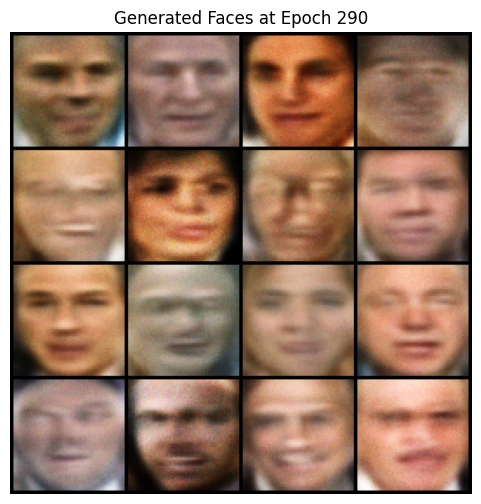

Epoch 291/500 | D Loss: 1.3781 | G Loss: 0.7599
Epoch 292/500 | D Loss: 1.3785 | G Loss: 0.7806
Epoch 293/500 | D Loss: 1.3734 | G Loss: 0.7801
Epoch 294/500 | D Loss: 1.3752 | G Loss: 0.7916
Epoch 295/500 | D Loss: 1.3737 | G Loss: 0.7731
Epoch 296/500 | D Loss: 1.3863 | G Loss: 0.7662
Epoch 297/500 | D Loss: 1.3757 | G Loss: 0.7889
Epoch 298/500 | D Loss: 1.3788 | G Loss: 0.7890
Epoch 299/500 | D Loss: 1.3756 | G Loss: 0.7777
Epoch 300/500 | D Loss: 1.3703 | G Loss: 0.7769


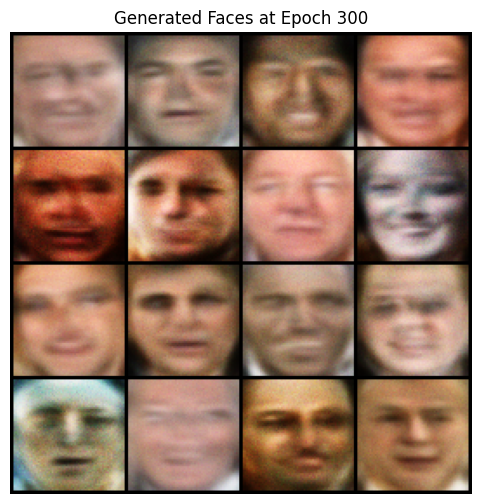

Epoch 301/500 | D Loss: 1.3869 | G Loss: 0.7769
Epoch 302/500 | D Loss: 1.3925 | G Loss: 0.7812
Epoch 303/500 | D Loss: 1.3776 | G Loss: 0.7875
Epoch 304/500 | D Loss: 1.3797 | G Loss: 0.7908
Epoch 305/500 | D Loss: 1.3742 | G Loss: 0.7620
Epoch 306/500 | D Loss: 1.3720 | G Loss: 0.7854
Epoch 307/500 | D Loss: 1.3827 | G Loss: 0.7899
Epoch 308/500 | D Loss: 1.3801 | G Loss: 0.7723
Epoch 309/500 | D Loss: 1.3809 | G Loss: 0.7740
Epoch 310/500 | D Loss: 1.3751 | G Loss: 0.7732


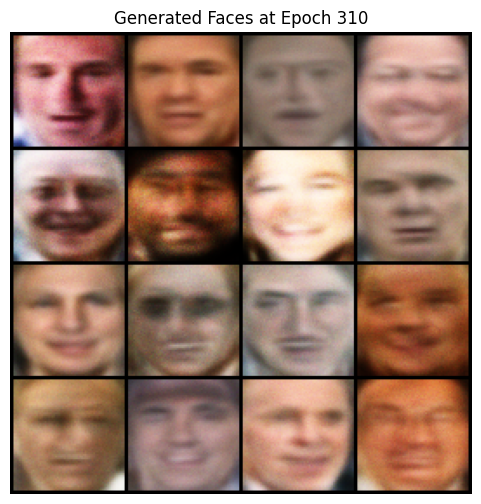

Epoch 311/500 | D Loss: 1.3742 | G Loss: 0.7644
Epoch 312/500 | D Loss: 1.3714 | G Loss: 0.7914
Epoch 313/500 | D Loss: 1.3693 | G Loss: 0.7771
Epoch 314/500 | D Loss: 1.3685 | G Loss: 0.7802
Epoch 315/500 | D Loss: 1.3817 | G Loss: 0.7792
Epoch 316/500 | D Loss: 1.3847 | G Loss: 0.7855
Epoch 317/500 | D Loss: 1.3832 | G Loss: 0.7784
Epoch 318/500 | D Loss: 1.3806 | G Loss: 0.7771
Epoch 319/500 | D Loss: 1.3782 | G Loss: 0.8238
Epoch 320/500 | D Loss: 1.3789 | G Loss: 0.7740


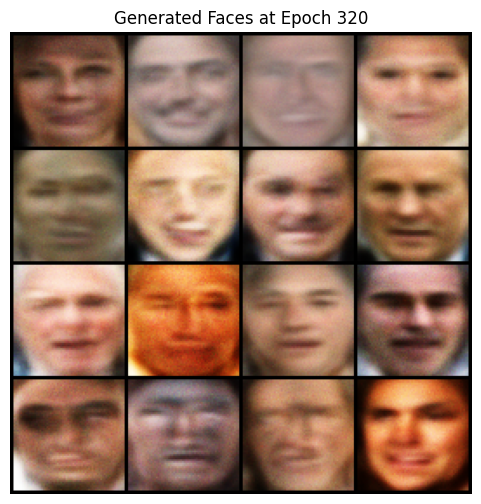

Epoch 321/500 | D Loss: 1.3737 | G Loss: 0.7969
Epoch 322/500 | D Loss: 1.3789 | G Loss: 0.7833
Epoch 323/500 | D Loss: 1.3737 | G Loss: 0.7737
Epoch 324/500 | D Loss: 1.3833 | G Loss: 0.7865
Epoch 325/500 | D Loss: 1.3787 | G Loss: 0.8020
Epoch 326/500 | D Loss: 1.3648 | G Loss: 0.7628
Epoch 327/500 | D Loss: 1.4143 | G Loss: 0.7790
Epoch 328/500 | D Loss: 1.4006 | G Loss: 0.7807
Epoch 329/500 | D Loss: 1.3519 | G Loss: 0.7810
Epoch 330/500 | D Loss: 1.3879 | G Loss: 0.7972


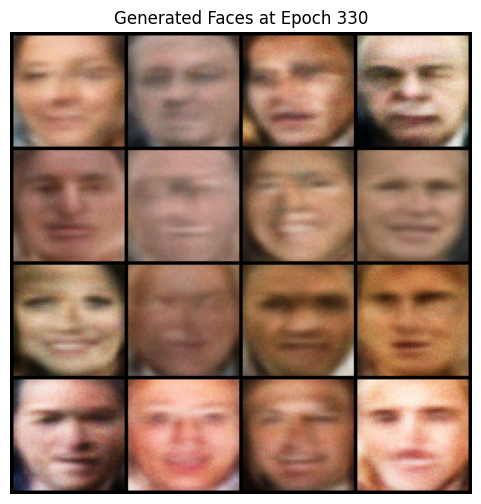

Epoch 331/500 | D Loss: 1.3754 | G Loss: 0.7774
Epoch 332/500 | D Loss: 1.3834 | G Loss: 0.8033
Epoch 333/500 | D Loss: 1.3680 | G Loss: 0.7775
Epoch 334/500 | D Loss: 1.3772 | G Loss: 0.7516
Epoch 335/500 | D Loss: 1.3721 | G Loss: 0.7839
Epoch 336/500 | D Loss: 1.3693 | G Loss: 0.7796
Epoch 337/500 | D Loss: 1.3768 | G Loss: 0.7692
Epoch 338/500 | D Loss: 1.3731 | G Loss: 0.7940
Epoch 339/500 | D Loss: 1.3729 | G Loss: 0.7750
Epoch 340/500 | D Loss: 1.4011 | G Loss: 0.7636


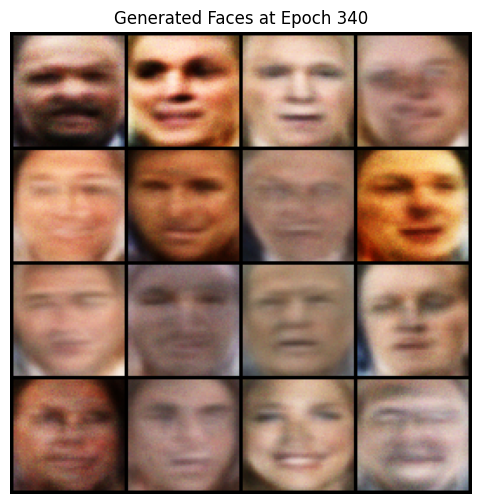

Epoch 341/500 | D Loss: 1.4016 | G Loss: 0.7966
Epoch 342/500 | D Loss: 1.3859 | G Loss: 0.7520
Epoch 343/500 | D Loss: 1.3582 | G Loss: 0.8198
Epoch 344/500 | D Loss: 1.3921 | G Loss: 0.7671
Epoch 345/500 | D Loss: 1.4049 | G Loss: 0.7495
Epoch 346/500 | D Loss: 1.3896 | G Loss: 0.7677
Epoch 347/500 | D Loss: 1.3616 | G Loss: 0.7696
Epoch 348/500 | D Loss: 1.3854 | G Loss: 0.7729
Epoch 349/500 | D Loss: 1.3698 | G Loss: 0.7878
Epoch 350/500 | D Loss: 1.3784 | G Loss: 0.7786


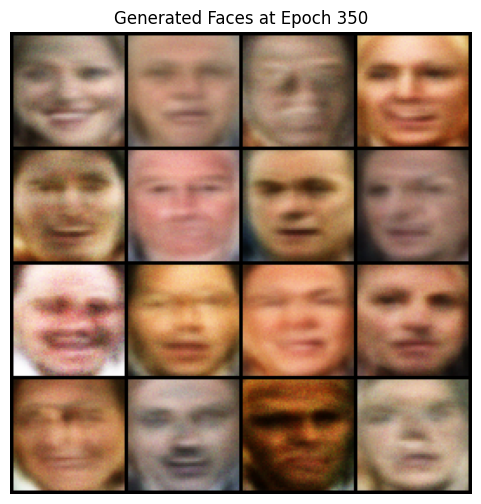

Epoch 351/500 | D Loss: 1.3763 | G Loss: 0.7862
Epoch 352/500 | D Loss: 1.3750 | G Loss: 0.7802
Epoch 353/500 | D Loss: 1.3728 | G Loss: 0.7716
Epoch 354/500 | D Loss: 1.3823 | G Loss: 0.7774
Epoch 355/500 | D Loss: 1.3789 | G Loss: 0.7689
Epoch 356/500 | D Loss: 1.3857 | G Loss: 0.7715
Epoch 357/500 | D Loss: 1.3719 | G Loss: 0.7978
Epoch 358/500 | D Loss: 1.3655 | G Loss: 0.7657
Epoch 359/500 | D Loss: 1.3564 | G Loss: 0.7965
Epoch 360/500 | D Loss: 1.3718 | G Loss: 0.8262


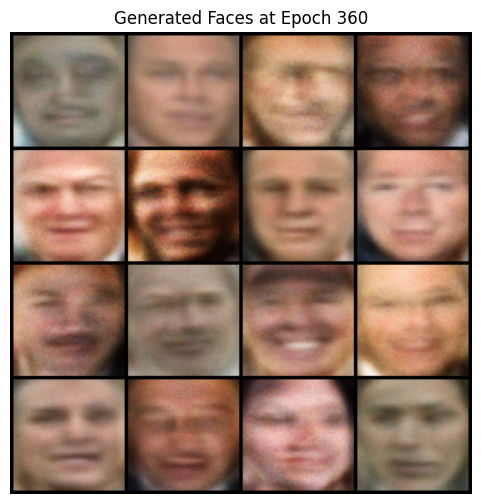

Epoch 361/500 | D Loss: 1.3731 | G Loss: 0.8051
Epoch 362/500 | D Loss: 1.3826 | G Loss: 0.7677
Epoch 363/500 | D Loss: 1.3674 | G Loss: 0.7453
Epoch 364/500 | D Loss: 1.3706 | G Loss: 0.7704
Epoch 365/500 | D Loss: 1.3634 | G Loss: 0.7813
Epoch 366/500 | D Loss: 1.3812 | G Loss: 0.7969
Epoch 367/500 | D Loss: 1.3550 | G Loss: 0.7899
Epoch 368/500 | D Loss: 1.3736 | G Loss: 0.7676
Epoch 369/500 | D Loss: 1.3671 | G Loss: 0.8193
Epoch 370/500 | D Loss: 1.3802 | G Loss: 0.8088


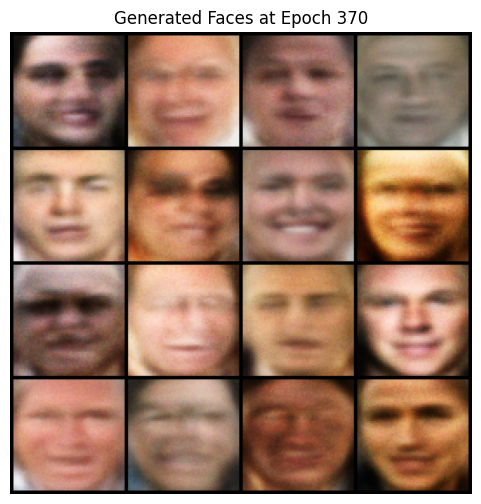

Epoch 371/500 | D Loss: 1.3695 | G Loss: 0.8085
Epoch 372/500 | D Loss: 1.3857 | G Loss: 0.7646
Epoch 373/500 | D Loss: 1.3707 | G Loss: 0.7773
Epoch 374/500 | D Loss: 1.3778 | G Loss: 0.7724
Epoch 375/500 | D Loss: 1.3794 | G Loss: 0.7765
Epoch 376/500 | D Loss: 1.3864 | G Loss: 0.7699
Epoch 377/500 | D Loss: 1.3770 | G Loss: 0.7943
Epoch 378/500 | D Loss: 1.3752 | G Loss: 0.7896
Epoch 379/500 | D Loss: 1.3868 | G Loss: 0.7991
Epoch 380/500 | D Loss: 1.3633 | G Loss: 0.7890


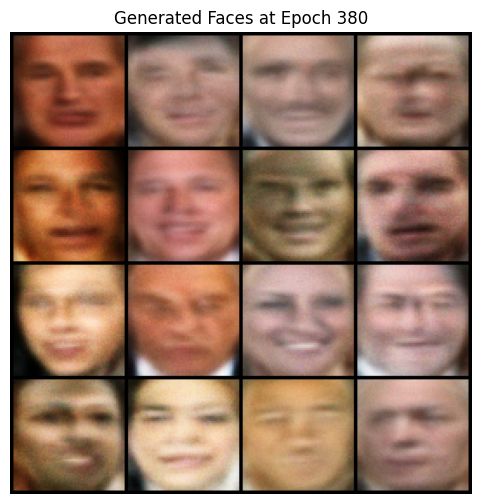

Epoch 381/500 | D Loss: 1.3783 | G Loss: 0.7561
Epoch 382/500 | D Loss: 1.3876 | G Loss: 0.7632
Epoch 383/500 | D Loss: 1.3705 | G Loss: 0.8020
Epoch 384/500 | D Loss: 1.3758 | G Loss: 0.7682
Epoch 385/500 | D Loss: 1.3739 | G Loss: 0.7820
Epoch 386/500 | D Loss: 1.3749 | G Loss: 0.7978
Epoch 387/500 | D Loss: 1.3807 | G Loss: 0.7791
Epoch 388/500 | D Loss: 1.3706 | G Loss: 0.7668
Epoch 389/500 | D Loss: 1.3651 | G Loss: 0.8087
Epoch 390/500 | D Loss: 1.3784 | G Loss: 0.7985


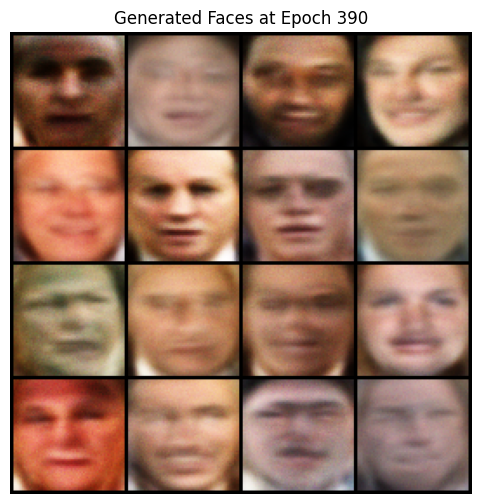

Epoch 391/500 | D Loss: 1.3720 | G Loss: 0.7807
Epoch 392/500 | D Loss: 1.3797 | G Loss: 0.7764
Epoch 393/500 | D Loss: 1.3764 | G Loss: 0.7799
Epoch 394/500 | D Loss: 1.3820 | G Loss: 0.7627
Epoch 395/500 | D Loss: 1.3788 | G Loss: 0.7983
Epoch 396/500 | D Loss: 1.3851 | G Loss: 0.7790
Epoch 397/500 | D Loss: 1.3861 | G Loss: 0.7760
Epoch 398/500 | D Loss: 1.3792 | G Loss: 0.7751
Epoch 399/500 | D Loss: 1.3738 | G Loss: 0.7839
Epoch 400/500 | D Loss: 1.3813 | G Loss: 0.7736


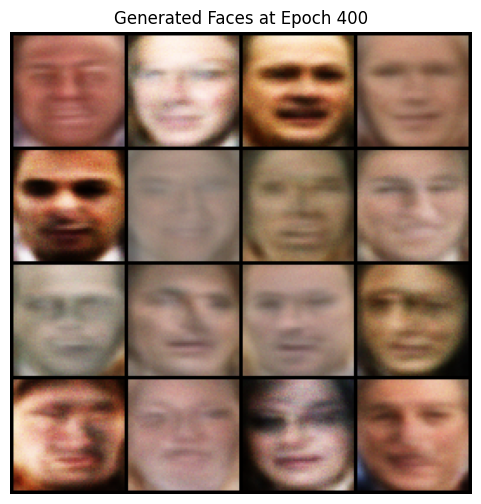

Epoch 401/500 | D Loss: 1.3812 | G Loss: 0.7716
Epoch 402/500 | D Loss: 1.3838 | G Loss: 0.7832
Epoch 403/500 | D Loss: 1.3717 | G Loss: 0.7674
Epoch 404/500 | D Loss: 1.3635 | G Loss: 0.8257
Epoch 405/500 | D Loss: 1.3767 | G Loss: 0.7827
Epoch 406/500 | D Loss: 1.3629 | G Loss: 0.8241
Epoch 407/500 | D Loss: 1.3732 | G Loss: 0.7942
Epoch 408/500 | D Loss: 1.3725 | G Loss: 0.7863
Epoch 409/500 | D Loss: 1.3653 | G Loss: 0.7647
Epoch 410/500 | D Loss: 1.3673 | G Loss: 0.7427


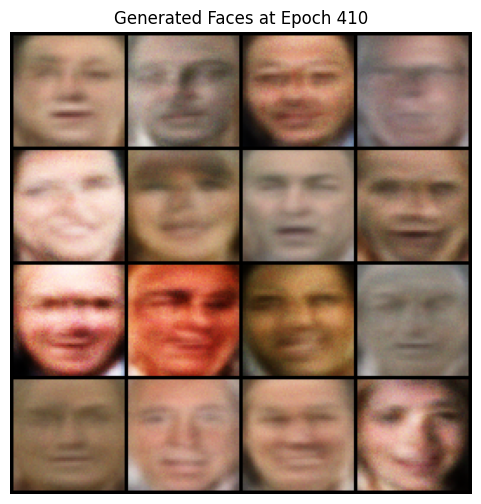

Epoch 411/500 | D Loss: 1.3892 | G Loss: 0.7817
Epoch 412/500 | D Loss: 1.3799 | G Loss: 0.7706
Epoch 413/500 | D Loss: 1.3579 | G Loss: 0.7761
Epoch 414/500 | D Loss: 1.3867 | G Loss: 0.7773
Epoch 415/500 | D Loss: 1.3793 | G Loss: 0.7992
Epoch 416/500 | D Loss: 1.3756 | G Loss: 0.7836
Epoch 417/500 | D Loss: 1.3780 | G Loss: 0.7741
Epoch 418/500 | D Loss: 1.3714 | G Loss: 0.7493
Epoch 419/500 | D Loss: 1.3783 | G Loss: 0.7775
Epoch 420/500 | D Loss: 1.3771 | G Loss: 0.7770


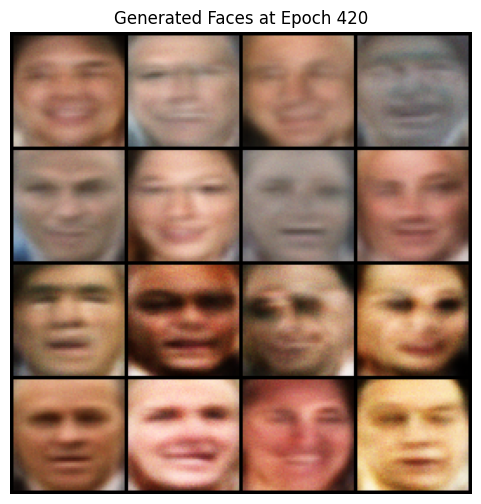

Epoch 421/500 | D Loss: 1.3772 | G Loss: 0.7908
Epoch 422/500 | D Loss: 1.3821 | G Loss: 0.7945
Epoch 423/500 | D Loss: 1.3834 | G Loss: 0.7826
Epoch 424/500 | D Loss: 1.3749 | G Loss: 0.7766
Epoch 425/500 | D Loss: 1.3753 | G Loss: 0.7759
Epoch 426/500 | D Loss: 1.3798 | G Loss: 0.7748
Epoch 427/500 | D Loss: 1.3810 | G Loss: 0.7834
Epoch 428/500 | D Loss: 1.3728 | G Loss: 0.7786
Epoch 429/500 | D Loss: 1.3758 | G Loss: 0.7598
Epoch 430/500 | D Loss: 1.3747 | G Loss: 0.7859


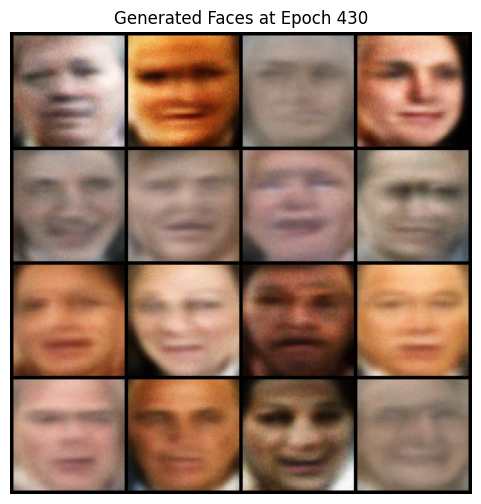

Epoch 431/500 | D Loss: 1.3757 | G Loss: 0.7759
Epoch 432/500 | D Loss: 1.3778 | G Loss: 0.7793
Epoch 433/500 | D Loss: 1.3909 | G Loss: 0.7709
Epoch 434/500 | D Loss: 1.3749 | G Loss: 0.7900
Epoch 435/500 | D Loss: 1.3769 | G Loss: 0.7697
Epoch 436/500 | D Loss: 1.3743 | G Loss: 0.7842
Epoch 437/500 | D Loss: 1.3759 | G Loss: 0.7698
Epoch 438/500 | D Loss: 1.3710 | G Loss: 0.7999
Epoch 439/500 | D Loss: 1.3779 | G Loss: 0.7948
Epoch 440/500 | D Loss: 1.3763 | G Loss: 0.7735


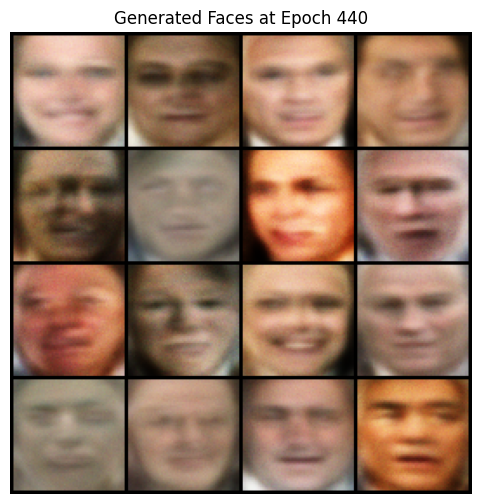

Epoch 441/500 | D Loss: 1.3851 | G Loss: 0.7855
Epoch 442/500 | D Loss: 1.3777 | G Loss: 0.7772
Epoch 443/500 | D Loss: 1.3781 | G Loss: 0.7944
Epoch 444/500 | D Loss: 1.3739 | G Loss: 0.7879
Epoch 445/500 | D Loss: 1.3775 | G Loss: 0.7754
Epoch 446/500 | D Loss: 1.3755 | G Loss: 0.7923
Epoch 447/500 | D Loss: 1.3739 | G Loss: 0.7569
Epoch 448/500 | D Loss: 1.3742 | G Loss: 0.7661
Epoch 449/500 | D Loss: 1.3741 | G Loss: 0.7559
Epoch 450/500 | D Loss: 1.3771 | G Loss: 0.7737


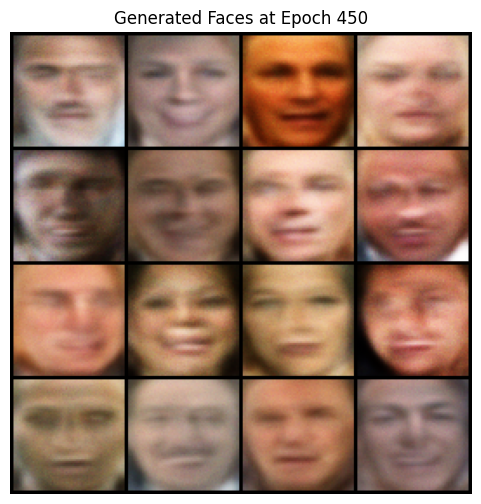

Epoch 451/500 | D Loss: 1.3771 | G Loss: 0.7878
Epoch 452/500 | D Loss: 1.3764 | G Loss: 0.7805
Epoch 453/500 | D Loss: 1.3948 | G Loss: 0.7736
Epoch 454/500 | D Loss: 1.3780 | G Loss: 0.8055
Epoch 455/500 | D Loss: 1.3790 | G Loss: 0.7862
Epoch 456/500 | D Loss: 1.3772 | G Loss: 0.8280
Epoch 457/500 | D Loss: 1.3838 | G Loss: 0.7771
Epoch 458/500 | D Loss: 1.3787 | G Loss: 0.7996
Epoch 459/500 | D Loss: 1.3815 | G Loss: 0.7817
Epoch 460/500 | D Loss: 1.3791 | G Loss: 0.7877


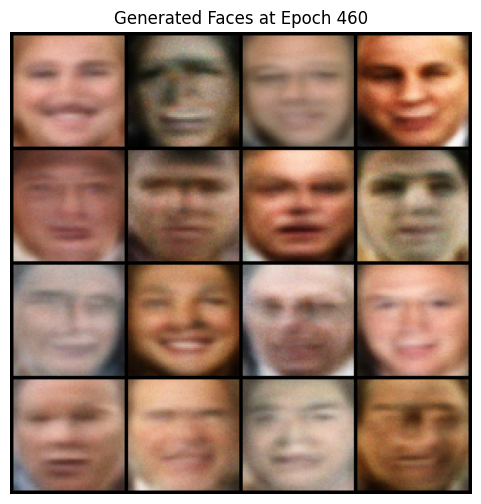

Epoch 461/500 | D Loss: 1.3785 | G Loss: 0.7652
Epoch 462/500 | D Loss: 1.3686 | G Loss: 0.7877
Epoch 463/500 | D Loss: 1.3557 | G Loss: 0.8675
Epoch 464/500 | D Loss: 1.3753 | G Loss: 0.7628
Epoch 465/500 | D Loss: 1.3719 | G Loss: 0.7899
Epoch 466/500 | D Loss: 1.3791 | G Loss: 0.7621
Epoch 467/500 | D Loss: 1.3797 | G Loss: 0.8109
Epoch 468/500 | D Loss: 1.3798 | G Loss: 0.7755
Epoch 469/500 | D Loss: 1.3741 | G Loss: 0.7782
Epoch 470/500 | D Loss: 1.3742 | G Loss: 0.7777


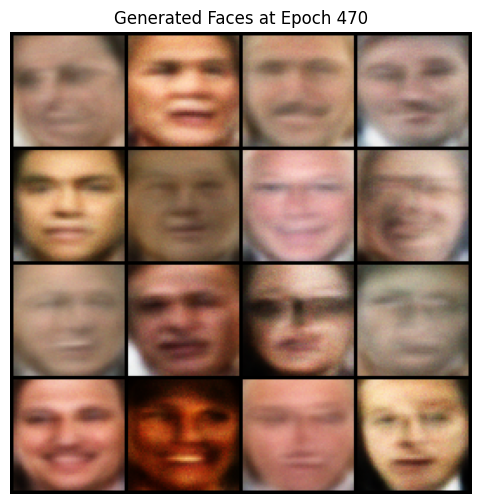

Epoch 471/500 | D Loss: 1.3717 | G Loss: 0.7811
Epoch 472/500 | D Loss: 1.3731 | G Loss: 0.7702
Epoch 473/500 | D Loss: 1.3739 | G Loss: 0.7761
Epoch 474/500 | D Loss: 1.3759 | G Loss: 0.7659
Epoch 475/500 | D Loss: 1.3781 | G Loss: 0.7497
Epoch 476/500 | D Loss: 1.3899 | G Loss: 0.7409
Epoch 477/500 | D Loss: 1.3130 | G Loss: 0.9055
Epoch 478/500 | D Loss: 1.3515 | G Loss: 0.7905
Epoch 479/500 | D Loss: 1.3653 | G Loss: 0.8211
Epoch 480/500 | D Loss: 1.3945 | G Loss: 0.7632


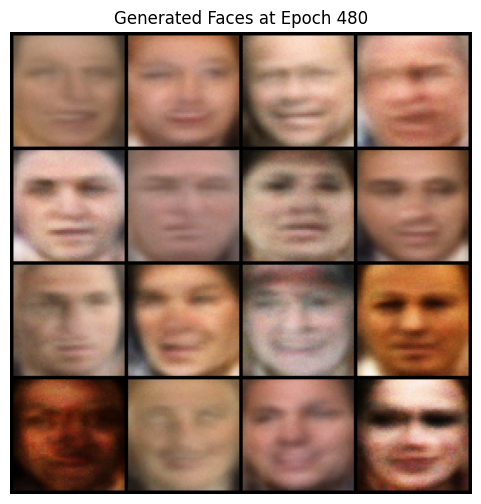

Epoch 481/500 | D Loss: 1.3916 | G Loss: 0.7661
Epoch 482/500 | D Loss: 1.3779 | G Loss: 0.7894
Epoch 483/500 | D Loss: 1.3758 | G Loss: 0.7687
Epoch 484/500 | D Loss: 1.3738 | G Loss: 0.7615
Epoch 485/500 | D Loss: 1.3800 | G Loss: 0.7725
Epoch 486/500 | D Loss: 1.3786 | G Loss: 0.7774
Epoch 487/500 | D Loss: 1.3766 | G Loss: 0.7940
Epoch 488/500 | D Loss: 1.3802 | G Loss: 0.7762
Epoch 489/500 | D Loss: 1.3826 | G Loss: 0.7756
Epoch 490/500 | D Loss: 1.3768 | G Loss: 0.7783


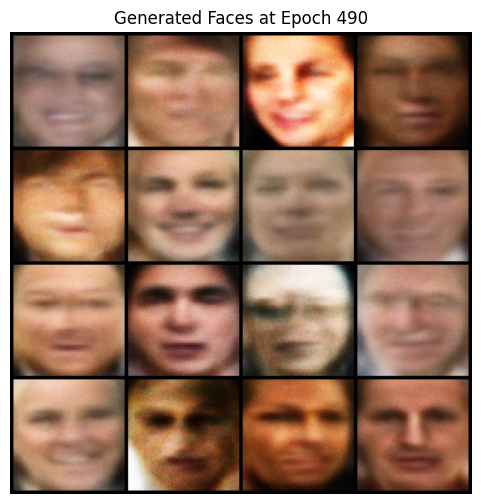

Epoch 491/500 | D Loss: 1.3763 | G Loss: 0.7796
Epoch 492/500 | D Loss: 1.3787 | G Loss: 0.7738
Epoch 493/500 | D Loss: 1.3730 | G Loss: 0.7839
Epoch 494/500 | D Loss: 1.3769 | G Loss: 0.7761
Epoch 495/500 | D Loss: 1.3811 | G Loss: 0.7770
Epoch 496/500 | D Loss: 1.3770 | G Loss: 0.7790
Epoch 497/500 | D Loss: 1.3765 | G Loss: 0.7864
Epoch 498/500 | D Loss: 1.3732 | G Loss: 0.7741
Epoch 499/500 | D Loss: 1.3785 | G Loss: 0.7783
Epoch 500/500 | D Loss: 1.3764 | G Loss: 0.7856


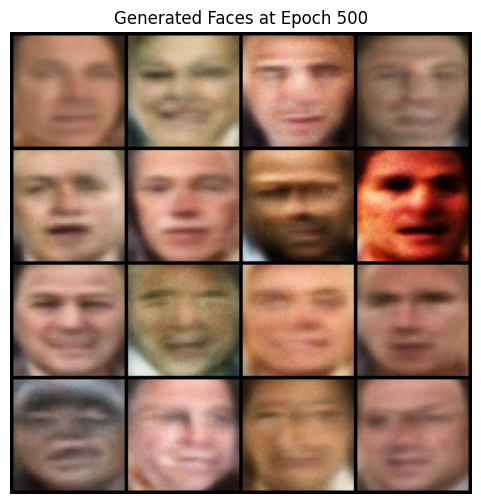

In [13]:
# GAN training
print("Training Basic GAN...")
d = 100
train_gan(generator(d), discriminator(), d=d, num_epochs=500)

In [14]:
# generate gif of training
import imageio
import glob

image_files = sorted(glob.glob("gan_frames/epoch_*.png"))
frames = []

for img_path in image_files:
    if os.path.exists(img_path):
        frames.append(imageio.imread(img_path))

if frames:
    imageio.mimsave("gan_training.gif", frames, duration=0.5)
    print(f"GIF created with {len(frames)} frames")
else:
    print("No frames found to create GIF")

<ipython-input-14-ba4d2df4b9bb>:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  frames.append(imageio.imread(img_path))


GIF created with 50 frames
